<div style="border-radius:10px;
            border:#0b0265 solid;
           background-color:#85e0e0;
           font-size:110%;
           letter-spacing:0.5px;
            text-align: center">

<center><h1 style="padding: 25px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
Ontario Infrastructure (Clustering) </h1></center>    

</div>

# <a name="toc"></a>

<div style="border-radius:10px;
            background-color: #66c2a5;
            border-style: solid;
            border-color: #0b0265;
            letter-spacing:0.5px;">

<center><h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
Table of Contents</h3></center>
</div>

- [1. Introduction and Dataset Features](#Introduction_and_Dataset_Features)
- [2. Import Libraries and Data](#Import_Libraries_and_Data)
- [3. Feature engineering & Exploratory Data Analysis(EDA)](#Prepare1)
- [4. Tuneing eps and min_samples](#Prepare2)
- [5. DBSCAN Clustering and Profile](#Clustering)
- [6. Mapping](#Folium_Mapping)
- [7. Power BI Dashboard Preparation](#Data_Visualization)

<a name='Introduction_and_Dataset_Features'></a>

<div style="border-radius:10px;
            background-color:#ffffff;
            border-style: solid;
            border-color: #0b0265;
            letter-spacing:0.5px;">

<center><h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
1. Introduction and Dataset Features</h3></center>
</div>

<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true" style="color:white" data-toggle="popover">Back to Table of Contents</a>

**Used Columns:**

* `_id`: Project's unique identifier
* `Category`: Project type(Community, Recreation, etc.)
* `Project Status`: Planning, Complete or Under Construction
* `Target Completion Date`: Planned projects finish time
* `Estimated Total Budget ($)`: Money dedicated for project
* `Municipal Funding`: Yes if project has Municipal Funding, NA if 0 municipal Funding         
* `Provincial Funding`: Yes if project has Provincial Funding, NA if 0 Procincial Funding
* `Federal Funding`: Yes if project has Federal Funding, NA if 0 Federal Funding
* `Other Funding`: Yes if project has Other Funding, NA if 0 Other Funding                                       
* `Latitude`: Accurate location of Project with Longitude
* `Longitude`: Accurate location of Project with Latitude
                                       
**Unused columns:**
* `Supporting Ministry`: Project's supporting Ministry
* `Community`: City that project belongs to geographically
* `Description`: Project explanation, summary
* `Result`: Project Purpose, Usage
* `Area`: Similar to Community
* `Region`: Part of Ontario project belongs to(west, Central)
* `Address`: Project's exact location
* `Postal Code`: Similar to Address
* `Highway / Transit Line`: Mostly NA
* `Website`: Project Information website

<a name='Import_Libraries_and_Data'></a>

<div style="border-radius:10px;
            background-color:#ffffff;
            border-style: solid;
            border-color: #0b0265;
            letter-spacing:0.5px;">

<center><h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
2. Import Libraries and Data</h3></center>
</div>

<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true" style="color:white" data-toggle="popover">Back to Table of Contents</a>

In [1]:
import branca
import folium
from folium.plugins import FeatureGroupSubGroup
from folium.plugins import MarkerCluster
from jinja2 import Template
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors
import numpy as np
import pandas as pd
import re
import seaborn as sns
from sklearn.cluster import DBSCAN
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler
import tabulate

<a name='Prepare1'></a>

<div style= 'border-radius:10px;
            background-color:#ffffff;
            border-style: solid;
            border-color: #0b0265;
            letter-spacing:0.5px;'>

<center><h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
3. Feature Engineering & Exploratory Data Analysis(EDA) </h3></center>
</div>

<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true" style="color:white" data-toggle="popover">Back to Table of Contents</a>

In [2]:
Ori_df = pd.read_csv('C:/Users/houju/Desktop/Data_Analysis_SelfLearn/Clustering_DataCamp_Self/Clustering_Ontario_Project/ontario_builds_cleaned.csv')
print(f"Total rows: {len(Ori_df)}")
# Status distribution
print("📊 Status Value Counts:")
print(Ori_df['Status'].value_counts(dropna=False))

# Category distribution
print("\n📊 Category Value Counts:")
print(Ori_df['Category'].value_counts(dropna=False))

Total rows: 3453
📊 Status Value Counts:
Status
Complete              3075
Under construction     216
Planning               162
Name: count, dtype: int64

📊 Category Value Counts:
Category
Communities          1842
Education             679
Child care            302
Roads and bridges     274
Transit               154
Recreation            120
Health care            82
Name: count, dtype: int64


In [2]:
Ori_df.head()

,_id,Category,Community,Status,Target Completion Date,Area,Region,Estimated Total Budget ($),Latitude,Longitude,Raw Completion Date,Municipal Funding_Flag,Provincial Funding_Flag,Federal Funding_Flag,Other Funding_Flag
0,2,Communities,Brampton,Complete,2024-12-23,Peel,Central,82500000,43.661701,-79.726047,23-Dec,0,1,0,0
1,9,Communities,Toronto,Complete,2024-01-23,Toronto,Central,956400000,43.653618,-79.386200,23-Jan,0,1,0,0
2,10,Communities,Toronto,Complete,2024-12-22,Toronto,Central,82500000,43.752606,-79.536505,22-Dec,0,1,0,0
3,11,Communities,Ajax,Complete,2024-10-24,Durham,Central,31000000,43.879000,-79.030000,24-Oct,0,1,1,1
4,12,Communities,Attawapiskat First Nation,Complete,2024-04-18,Kenora,Northwest,1200000,52.550000,-82.260000,18-Apr,0,1,0,0


In [3]:
Ori_df['Target Completion Date'] = pd.to_datetime(Ori_df['Target Completion Date'])
Ori_df['Completion_Year'] = Ori_df['Target Completion Date'].dt.year
Ori_df['Category'] = pd.Categorical(Ori_df['Category'], categories=['Recreation', 'Communities', 'Education', 'Child care', 'Roads and bridges', 
                                                      'Transit', 'Health care'])
df_dummy = pd.get_dummies(Ori_df[[
    'Latitude', 'Longitude',
    'Estimated Total Budget ($)',
    'Completion_Year',
    'Status', 'Category',
    'Provincial Funding_Flag',
    'Federal Funding_Flag',
    'Municipal Funding_Flag',
    'Other Funding_Flag',
]], columns=['Status', 'Category'], drop_first=False)

df_dummy.head()


,Latitude,Longitude,Estimated Total Budget ($),Completion_Year,Provincial Funding_Flag,Federal Funding_Flag,Municipal Funding_Flag,Other Funding_Flag,Status_Complete,Status_Planning,Status_Under construction,Category_Recreation,Category_Communities,Category_Education,Category_Child care,Category_Roads and bridges,Category_Transit,Category_Health care
0,43.661701,-79.726047,82500000,2024,1,0,0,0,True,False,False,False,True,False,False,False,False,False
1,43.653618,-79.386200,956400000,2024,1,0,0,0,True,False,False,False,True,False,False,False,False,False
2,43.752606,-79.536505,82500000,2024,1,0,0,0,True,False,False,False,True,False,False,False,False,False
3,43.879000,-79.030000,31000000,2024,1,1,0,1,True,False,False,False,True,False,False,False,False,False
4,52.550000,-82.260000,1200000,2024,1,0,0,0,True,False,False,False,True,False,False,False,False,False


In [4]:
# Select features to scale
features_to_scale = ['Estimated Total Budget ($)', 'Completion_Year']
df_scaled = df_dummy.copy()
df_scaled[features_to_scale] = StandardScaler().fit_transform(df_dummy[features_to_scale])
# Excluding lat/lon for multi-feature clustering)
df_noloc = df_scaled.drop(['Latitude', 'Longitude'], axis=1)

In [5]:
# Count number of provincially funded projects
provincial_count = df_dummy['Provincial Funding_Flag'].sum()
total_projects = len(df_dummy)

print(f"Provincially funded projects: {provincial_count} / {total_projects} ({provincial_count/total_projects:.1%})")


Provincially funded projects: 3415 / 3453 (98.9%)


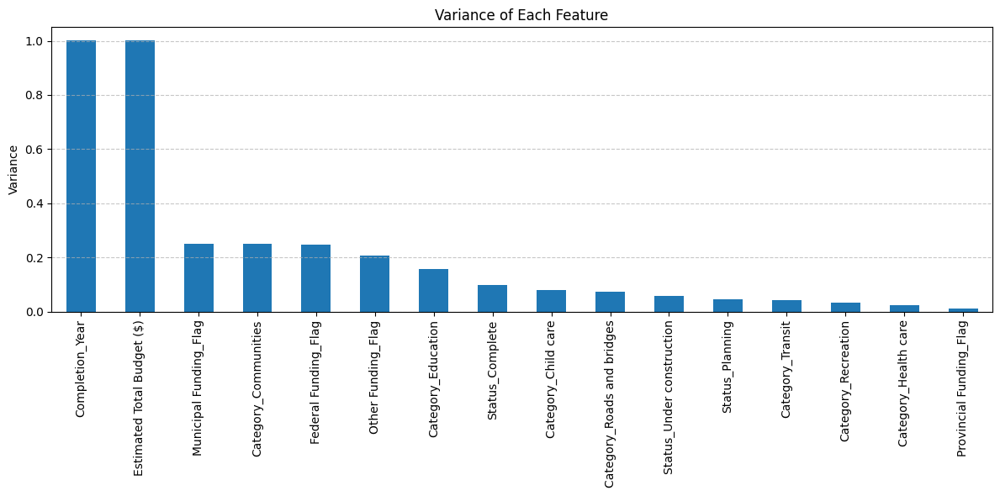

Completion_Year               1.000290
Estimated Total Budget ($)    1.000290
Municipal Funding_Flag        0.249690
Category_Communities          0.248953
Federal Funding_Flag          0.247719
Other Funding_Flag            0.206763
Category_Education            0.158019
Status_Complete               0.097515
Category_Child care           0.079834
Category_Roads and bridges    0.073076
Status_Under construction     0.058658
Status_Planning               0.044728
Category_Transit              0.042622
Category_Recreation           0.033554
Category_Health care          0.023190
Provincial Funding_Flag       0.010887
dtype: float64


In [6]:

# Calculate variance for each feature
feature_variances = df_noloc.var().sort_values(ascending=False)
plt.figure(figsize=(12, 6))
feature_variances.plot(kind='bar')
plt.title('Variance of Each Feature')
plt.ylabel('Variance')
plt.xticks(rotation=90)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()
print(feature_variances)

<a name='Prepare2'></a>

<div style= 'border-radius:10px;
            background-color:#ffffff;
            border-style: solid;
            border-color: #0b0265;
            letter-spacing:0.5px;'>

<center><h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
4. Tuneing eps and min_samples </h3></center>
</div>

<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true" style="color:white" data-toggle="popover">Back to Table of Contents</a>

In [7]:
# Tune eps and minimum sample values
eps_values = np.arange(0.1, 1.0, 0.1)
min_samples_values = [5, 10, 15, 20]

results = []

for eps in eps_values:
    for min_samples in min_samples_values:
        db = DBSCAN(eps=eps, min_samples=min_samples)
        labels = db.fit_predict(df_noloc)
        
        n_clusters = len(set(labels)) - (1 if -1 in labels else 0)
        n_noise = list(labels).count(-1)

        if n_clusters > 1:
            try:
                score = silhouette_score(df_noloc[labels != -1], labels[labels != -1])
            except:
                score = np.nan
        else:
            score = np.nan

        results.append({
            'eps': eps,
            'min_samples': min_samples,
            'n_clusters': n_clusters,
            'n_noise': n_noise,
            'silhouette': score
        })

# Convert to DataFrame for sorting/inspection
results_df = pd.DataFrame(results)
print(results_df)


    eps  min_samples  n_clusters  n_noise  silhouette
0   0.1            5          46      206    0.964854
1   0.1           10          32      335    0.967740
2   0.1           15          26      423    0.969722
3   0.1           20          23      485    0.971260
4   0.2            5          48      163    0.957057
5   0.2           10          34      264    0.961522
6   0.2           15          28      338    0.962487
7   0.2           20          24      419    0.964987
8   0.3            5          48      154    0.955597
9   0.3           10          35      241    0.958058
10  0.3           15          28      326    0.959407
11  0.3           20          26      361    0.959980
12  0.4            5          47      144    0.950818
13  0.4           10          35      233    0.955389
14  0.4           15          28      317    0.956626
15  0.4           20          26      353    0.957819
16  0.5            5          47      142    0.950142
17  0.5           10        

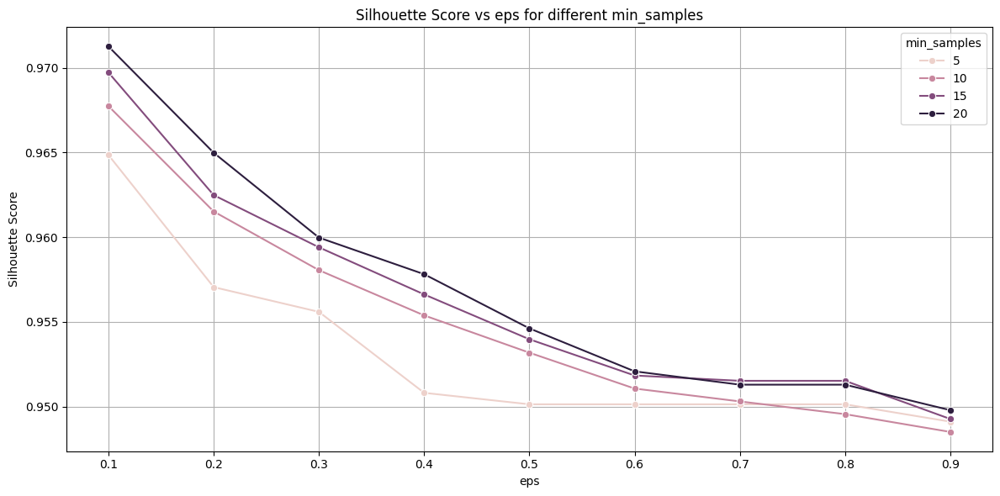

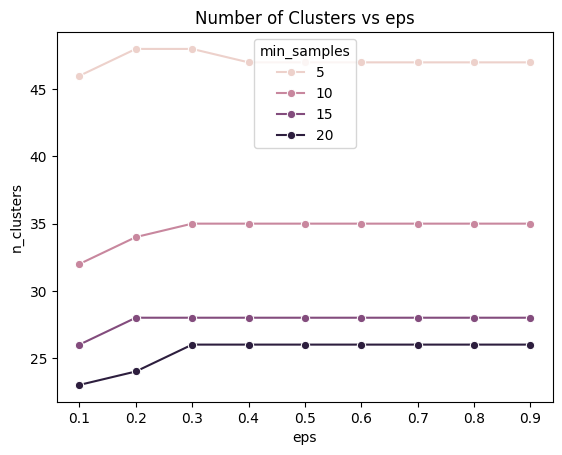

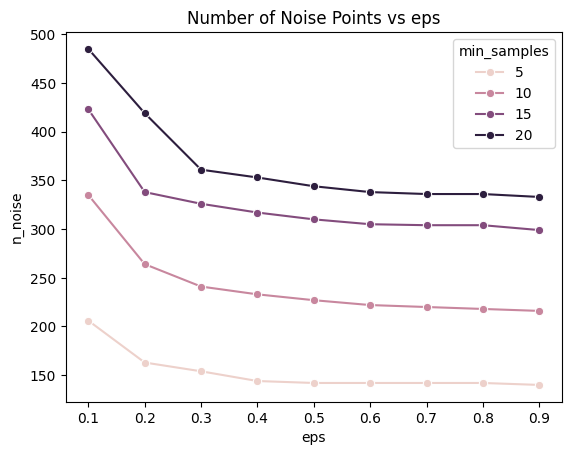

In [8]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=results_df, x="eps", y="silhouette", hue="min_samples", marker='o')
plt.title("Silhouette Score vs eps for different min_samples")
plt.xlabel("eps")
plt.ylabel("Silhouette Score")
plt.legend(title="min_samples")
plt.grid(True)
plt.tight_layout()
plt.show()
# Clusters
sns.lineplot(data=results_df, x="eps", y="n_clusters", hue="min_samples", marker='o')
plt.title("Number of Clusters vs eps")
plt.show()

# Noise points
sns.lineplot(data=results_df, x="eps", y="n_noise", hue="min_samples", marker='o')
plt.title("Number of Noise Points vs eps")
plt.show()


<a name='Clustering'></a>

<div style= 'border-radius:10px;
            background-color:#ffffff;
            border-style: solid;
            border-color: #0b0265;
            letter-spacing:0.5px;'>

<center><h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
5. DBSCAN Clustering and Profile</h3></center>
</div>

<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true" style="color:white" data-toggle="popover">Back to Table of Contents</a>

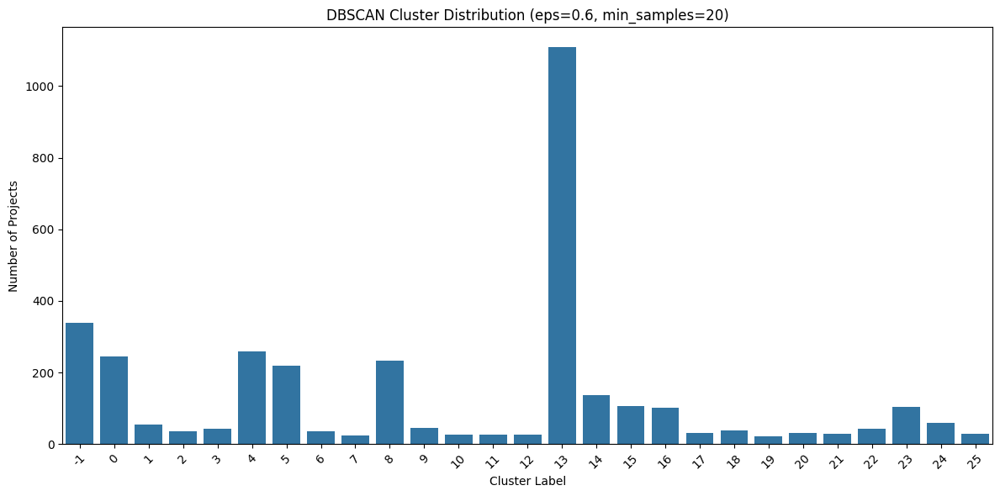

In [9]:
# Chosen parameters
eps = 0.6
min_samples = 20

# Fit DBSCAN
dbscan = DBSCAN(eps=eps, min_samples=min_samples)
df_noloc['DBSCAN_Cluster'] = dbscan.fit_predict(df_noloc)
df_dummy['DBSCAN_Cluster'] = dbscan.fit_predict(df_noloc)
plt.figure(figsize=(12, 6))
sns.countplot(x='DBSCAN_Cluster', data=df_noloc, order=sorted(df_noloc['DBSCAN_Cluster'].unique()))
plt.title("DBSCAN Cluster Distribution (eps=0.6, min_samples=20)")
plt.xlabel("Cluster Label")
plt.ylabel("Number of Projects")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [10]:
# Merge back the DBSCAN labels into the original (non-dummy) dataframe
df_profile = df_dummy.copy()
df_profile = df_profile.drop(['Latitude','Longitude'],axis=1)
# Extract Project count, average budget, median year
base_stats = df_profile.groupby('DBSCAN_Cluster').agg(
    Project_Count=('DBSCAN_Cluster', 'count'),
    Avg_Budget=('Estimated Total Budget ($)', 'mean'),
    Median_Completion_Year=('Completion_Year', 'mean')
)

# Select common Category from dummies
category_cols = [col for col in df_profile.columns if col.startswith('Category_')]
top_category = df_profile.groupby('DBSCAN_Cluster')[category_cols].mean().idxmax(axis=1)
top_category = top_category.str.replace('Category_', '')

# Get most common Status from dummies
status_cols = [col for col in df_profile.columns if col.startswith('Status_')]
top_status = df_profile.groupby('DBSCAN_Cluster')[status_cols].mean().idxmax(axis=1)
top_status = top_status.str.replace('Status_', '')

#Combine all into one summary table
cluster_profile = base_stats.copy()
cluster_profile["Top_Category"] = top_category
cluster_profile["Top_Status"] = top_status

# Sort by project count
cluster_profile = cluster_profile.sort_values(by="Project_Count", ascending=False)

print(cluster_profile)



                Project_Count    Avg_Budget  Median_Completion_Year   
DBSCAN_Cluster                                                        
 13                      1109  8.941177e+05             2024.000000  \
-1                        338  6.354468e+07             2024.136095   
 4                        258  1.308952e+07             2024.000000   
 0                        246  8.809752e+05             2024.000000   
 8                        234  6.544739e+06             2024.000000   
 5                        218  1.138317e+06             2024.000000   
 14                       136  2.946341e+06             2024.000000   
 15                       107  1.385748e+06             2024.000000   
 23                       104  1.545129e+06             2024.000000   
 16                       101  1.067649e+06             2024.000000   
 24                        60  6.570606e+06             2024.000000   
 1                         55  8.669130e+06             2024.000000   
 9    

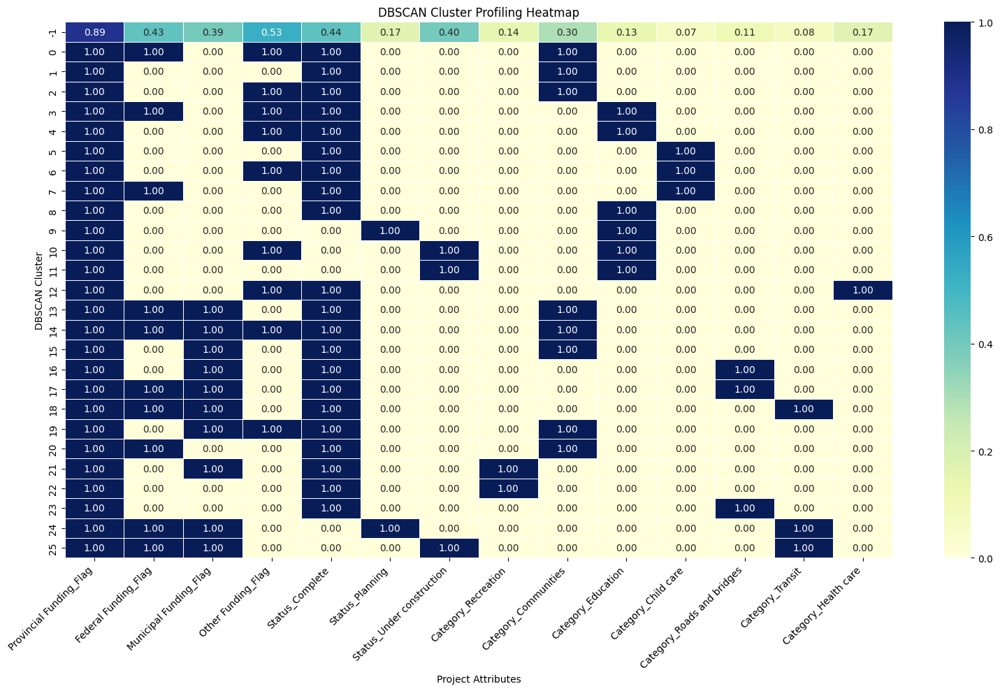

In [11]:
# Choose dummy columns for profile
dummy_cols = [col for col in df_profile.columns if col.startswith('Category_') 
              or col.startswith('Status_') 
              or col.endswith('Funding_Flag')]

# Group by DBSCAN cluster and compute average value of each dummy
# This gives % of projects in each cluster with a given attribute
heatmap_data = df_profile.groupby('DBSCAN_Cluster')[dummy_cols].mean()

plt.figure(figsize=(16, 10))
sns.heatmap(heatmap_data, annot=True, cmap='YlGnBu', fmt='.2f', linewidths=0.5)

plt.title("DBSCAN Cluster Profiling Heatmap")
plt.xlabel("Project Attributes")
plt.ylabel("DBSCAN Cluster")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# Reset index to include cluster number in the output
heatmap_table = heatmap_data.reset_index()


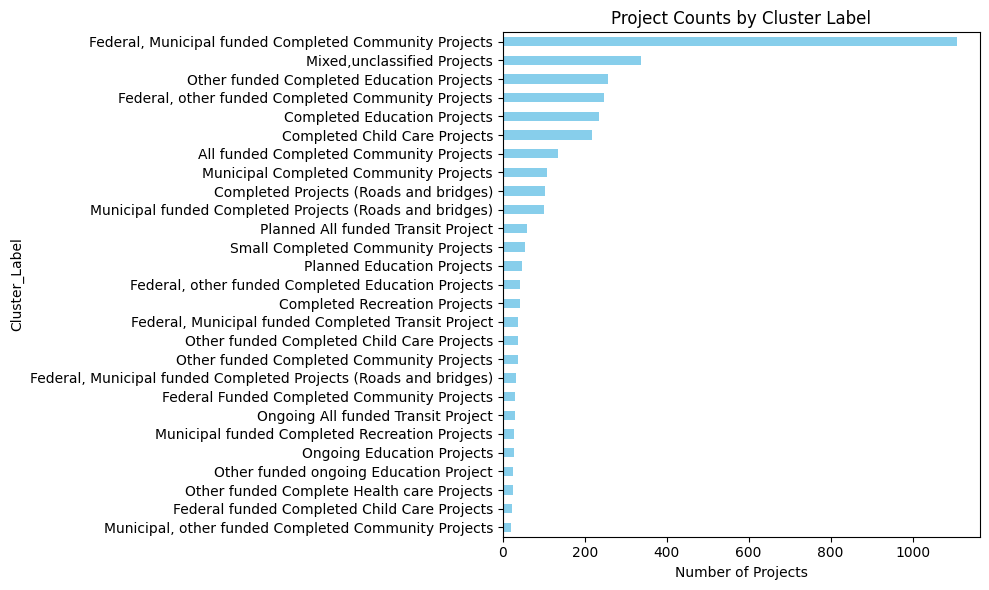

In [13]:
# 99% projects are provincially funded, most projects are in 2023-2025
cluster_labels = {
    -1: "Mixed,unclassified Projects",
     0: "Federal, other funded Completed Community Projects",
     1: "Small Completed Community Projects",
     2: "Other funded Completed Community Projects",
     3: "Federal, other funded Completed Education Projects",
     4: "Other funded Completed Education Projects",
     5: "Completed Child Care Projects",
     6: "Other funded Completed Child Care Projects",
     7: "Federal funded Completed Child Care Projects",
     8: "Completed Education Projects",
     9: "Planned Education Projects",
    10: "Other funded ongoing Education Project",
    11: "Ongoing Education Projects",
    12: "Other funded Complete Health care Projects",
    13: "Federal, Municipal funded Completed Community Projects",
    14: "All funded Completed Community Projects",
    15: "Municipal Completed Community Projects",
    16: "Municipal funded Completed Projects (Roads and bridges)",
    17: "Federal, Municipal funded Completed Projects (Roads and bridges)",
    18: "Federal, Municipal funded Completed Transit Project",
    19: "Municipal, other funded Completed Community Projects",
    20: "Federal Funded Completed Community Projects",
    21: "Municipal funded Completed Recreation Projects",
    22: "Completed Recreation Projects",
    23: "Completed Projects (Roads and bridges)",
    24: "Planned All funded Transit Project",
    25: "Ongoing All funded Transit Project"
}
# Replace with your actual DBSCAN cluster column
df_noloc['Cluster_Label'] = df_noloc['DBSCAN_Cluster'].map(cluster_labels)
df_dummy['Cluster_Label'] = df_dummy['DBSCAN_Cluster'].map(cluster_labels)
label_counts = df_noloc['Cluster_Label'].value_counts().sort_values(ascending=False)

plt.figure(figsize=(10, 6))
label_counts.plot(kind='barh', color='skyblue')
plt.title("Project Counts by Cluster Label")
plt.xlabel("Number of Projects")
plt.gca().invert_yaxis()
plt.tight_layout()
plt.show()

<a name='Folium_Mapping'></a>

<div style= 'border-radius:10px;
            background-color:#ffffff;
            border-style: solid;
            border-color: #0b0265;
            letter-spacing:0.5px;'>

<center><h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
6. Mapping </h3></center>
</div>

<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true" style="color:white" data-toggle="popover">Back to Table of Contents</a>

In [14]:
def classify_funding_level(budget):
    if budget < 100_000:
        return "Near Zero", "#d0d0d0"
    elif budget < 1_000_000:
        return "Low", "#a6cee3"
    elif budget < 5_000_000:
        return "Medium", "#1f78b4"
    elif budget < 10_000_000:
        return "Large", "#b2df8a"
    else:
        return "Extremely Large", "#33a02c"

funding_colors = {
    "Near Zero": "#d0d0d0",
    "Low": "#a6cee3",
    "Medium": "#1f78b4",
    "Large": "#b2df8a",
    "Extremely Large": "#33a02c"
}
df_dummy[['Funding_Level', 'Funding_Color']] = df_dummy['Estimated Total Budget ($)'].apply(
    lambda x: pd.Series(classify_funding_level(x))
)
# Reconstruct 'Category' column from one-hot encoded category columns
category_cols = [col for col in df_dummy.columns if col.startswith('Category_')]

def get_category(row):
    for col in category_cols:
        if row[col]:
            return col.replace('Category_', '')
    return 'Unknown'

df_dummy['Category'] = df_dummy.apply(get_category, axis=1)



In [18]:
# Setup base map
m = folium.Map(location=[51.2538, -85.3232], zoom_start=5)

# Base hidden layer for subgroup control
base = folium.FeatureGroup(name="All Projects (hidden base)", show=False)
m.add_child(base)

# Create cluster layers using Cluster_Label
cluster_groups = {}
for label in sorted(df_dummy['Cluster_Label'].unique()):
    group = FeatureGroupSubGroup(base, name=label)
    m.add_child(group)
    cluster_groups[label] = group

# Add markers
for _, row in df_dummy.iterrows():
    label = row['Cluster_Label']
    color = row['Funding_Color']
    year = row['Completion_Year']

    popup_info = f"""
    <b>Cluster:</b> {label}<br>
    <b>Funding Level:</b> {row['Funding_Level']}<br>
    <b>Budget:</b> ${row['Estimated Total Budget ($)']:,.0f}<br>
    <b>Completion Year:</b> {year}<br>
    <b>Top Category:</b> {row['Category']}<br>
    <b>Funding:</b><br>
    &emsp;<b>Provincial:</b> {'✅' if row['Provincial Funding_Flag'] else '❌'}<br>
    &emsp;<b>Federal:</b> {'✅' if row['Federal Funding_Flag'] else '❌'}<br>
    &emsp;<b>Municipal:</b> {'✅' if row['Municipal Funding_Flag'] else '❌'}<br>
    &emsp;<b>Other:</b> {'✅' if row['Other Funding_Flag'] else '❌'}<br>
    """

    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=5,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.8,
        popup=folium.Popup(popup_info, max_width=300)
    ).add_to(cluster_groups[label])

# Add Funding Level Legend
funding_colors = {
    level: color for level, color in zip(
        df_dummy['Funding_Level'].unique(), df_dummy['Funding_Color'].unique()
    )
}

funding_legend_html = """
{% macro html(this, kwargs) %}
<div style="position: fixed; bottom: 50px; left: 50px; width: 250px; background-color: white; 
            z-index:9999; font-size:14px; border:2px solid grey; border-radius:8px; padding: 10px;">
    <b>Funding Level Legend</b><br>
    {% for level, color in this.funding_colors.items() %}
        <i style="background:{{ color }};width:14px;height:14px;display:inline-block;
                  margin-right:8px;border:1px solid #555;"></i>{{ level }}<br>
    {% endfor %}
</div>
{% endmacro %}
"""

class FundingLegend(branca.element.MacroElement):
    def __init__(self, funding_colors):
        super().__init__()
        self._name = 'FundingLegend'
        self.funding_colors = funding_colors
        self._template = branca.element.Template(funding_legend_html)

m.get_root().add_child(FundingLegend(funding_colors))

# Add layer control
folium.LayerControl(collapsed=False).add_to(m)

# Save map
m.save("Cluster_Map.html")
m

In [19]:
# Create main map
m = folium.Map(location=[51.2538, -85.3232], zoom_start=5)

subgroups = {}

# Define filter subgroups and set 2024 checked
for year in sorted(df_dummy['Completion_Year'].unique()):
    for status in ['Planning', 'Under construction']:
        name = f"{year} - {status}"
        show_layer = year == 2024
        subgroup = folium.FeatureGroup(name=name, show=show_layer)
        m.add_child(subgroup)
        subgroups[name] = subgroup

# Add filtered markers with Funding_Color
for _, row in df_dummy.iterrows():
    lat, lon = row['Latitude'], row['Longitude']
    if pd.notna(lat) and pd.notna(lon):
        year = row['Completion_Year']
        status = "Planning" if row['Status_Planning'] else "Under construction"
        layer_key = f"{year} - {status}"

        popup_info = f"""
        <b>Cluster:</b> {row['DBSCAN_Cluster']}<br>
        <b>Top Category:</b> {row.get('Category', 'Unknown')}<br>
        <b>Funding Level:</b> {row['Funding_Level']}<br>
        <b>Budget:</b> ${row['Estimated Total Budget ($)']:,.0f}<br>
        <b>Completion Year:</b> {year}<br>
        <b>Funding:</b><br>
        &emsp;<b>Provincial:</b> {'✅' if row['Provincial Funding_Flag'] else '❌'}<br>
        &emsp;<b>Federal:</b> {'✅' if row['Federal Funding_Flag'] else '❌'}<br>
        &emsp;<b>Municipal:</b> {'✅' if row['Municipal Funding_Flag'] else '❌'}<br>
        &emsp;<b>Other:</b> {'✅' if row['Other Funding_Flag'] else '❌'}<br>
        """

        marker = folium.CircleMarker(
            location=[lat, lon],
            radius=5,
            color=row['Funding_Color'],
            fill=True,
            fill_color=row['Funding_Color'],
            fill_opacity=0.7,
            popup=folium.Popup(popup_info, max_width=300)
        )

        if layer_key in subgroups:
            marker.add_to(subgroups[layer_key])

# Add legend for funding levels
funding_colors = df_dummy.set_index('Funding_Level')['Funding_Color'].dropna().to_dict()

funding_legend_html = """
{% macro html(this, kwargs) %}
<div style="position: fixed; bottom: 50px; left: 50px; width: 250px; background-color: white; 
            z-index:9999; font-size:14px; border:2px solid grey; border-radius:8px; padding: 10px;">
    <b>Funding Level Legend</b><br>
    {% for level, color in this.funding_colors.items() %}
        <i style="background:{{ color }};width:14px;height:14px;display:inline-block;
                  margin-right:8px;border:1px solid #555;"></i>{{ level }}<br>
    {% endfor %}
</div>
{% endmacro %}
"""

class FundingLegend(branca.element.MacroElement):
    def __init__(self, funding_colors):
        super().__init__()
        self._name = 'FundingLegend'
        self.funding_colors = funding_colors
        self._template = branca.element.Template(funding_legend_html)

m.get_root().add_child(FundingLegend(funding_colors))

# Layer Control
folium.LayerControl(collapsed=False).add_to(m)
m.save("Funding map.html")
m


In [20]:
# Define category colors
category_colors = {
    'Communities': '#66c2a5',
    'Education': '#fc8d62',
    'Child care': '#8da0cb',
    'Roads and bridges': '#e78ac3',
    'Transit': '#a6d854',
    'Health care': '#ffd92f',
    'Recreation': '#e5c494',
    'Unknown': '#b3b3b3'
}

# Main map
m = folium.Map(location=[51.2538, -85.3232], zoom_start=5)

# Define filter subgroups for Year and Status
subgroups = {}

for year in sorted(df_dummy['Completion_Year'].unique()):
    for status in ['Planning', 'Under construction']:
        name = f"{year} - {status}"
        show_layer = True if year == 2024 else False  
        subgroup = folium.FeatureGroup(name=name, show=show_layer)
        m.add_child(subgroup)
        subgroups[name] = subgroup

# Add filtered markers colored by Category
for _, row in df_dummy.iterrows():
    lat, lon = row['Latitude'], row['Longitude']
    if pd.notna(lat) and pd.notna(lon):
        year = row['Completion_Year']
        status = "Planning" if row['Status_Planning'] else "Under construction"
        layer_key = f"{year} - {status}"

        category = row.get('Category', 'Unknown')
        color = category_colors.get(category, '#b3b3b3')

        popup_info = f"""
        <b>Cluster:</b> {row['DBSCAN_Cluster']}<br>
        <b>Top Category:</b> {category}<br>
        <b>Funding Level:</b> {row['Funding_Level']}<br>
        <b>Budget:</b> ${row['Estimated Total Budget ($)']:,.0f}<br>
        <b>Completion Year:</b> {year}<br>
        <b>Funding:</b><br>
        &emsp;<b>Provincial:</b> {'✅' if row['Provincial Funding_Flag'] else '❌'}<br>
        &emsp;<b>Federal:</b> {'✅' if row['Federal Funding_Flag'] else '❌'}<br>
        &emsp;<b>Municipal:</b> {'✅' if row['Municipal Funding_Flag'] else '❌'}<br>
        &emsp;<b>Other:</b> {'✅' if row['Other Funding_Flag'] else '❌'}<br>
        """

        marker = folium.CircleMarker(
            location=[lat, lon],
            radius=5,
            color=color,
            fill=True,
            fill_color=color,
            fill_opacity=0.7,
            popup=folium.Popup(popup_info, max_width=300)
        )

        if layer_key in subgroups:
            marker.add_to(subgroups[layer_key])

# Add legend for category colors
category_legend_html = """
{% macro html(this, kwargs) %}
<div style="position: fixed; bottom: 50px; left: 50px; width: 220px; background-color: white; 
            z-index:9999; font-size:14px; border:2px solid grey; border-radius:8px; padding: 10px;">
    <b>Top Category Legend</b><br>
    {% for cat, color in this.category_colors.items() %}
        <i style="background:{{ color }};width:14px;height:14px;display:inline-block;
                  margin-right:8px;border:1px solid #555;"></i>{{ cat }}<br>
    {% endfor %}
</div>
{% endmacro %}
"""

class CategoryLegend(branca.element.MacroElement):
    def __init__(self, category_colors):
        super().__init__()
        self._name = 'CategoryLegend'
        self.category_colors = category_colors
        self._template = branca.element.Template(category_legend_html)

m.get_root().add_child(CategoryLegend(category_colors))

# Layer Control
folium.LayerControl(collapsed=False).add_to(m)
m.save("Category map.html")
m

<a name='Data_Visualization'></a>

<div style= 'border-radius:10px;
            background-color:#ffffff;
            border-style: solid;
            border-color: #0b0265;
            letter-spacing:0.5px;'>

<center><h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
7. Power BI Dashboard Preparation </h3></center>
</div>

<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true" style="color:white" data-toggle="popover">Back to Table of Contents</a>

    DBSCAN_Cluster  Project_Count    Avg_Budget  Median_Completion_Year   
0               -1            338  6.354468e+07                  2024.0  \
1                0            246  8.809752e+05                  2024.0   
2                1             55  8.669130e+06                  2024.0   
3                2             37  2.125278e+06                  2024.0   
4                3             43  2.225418e+07                  2024.0   
5                4            258  1.308952e+07                  2024.0   
6                5            218  1.138317e+06                  2024.0   
7                6             37  1.775032e+06                  2024.0   
8                7             23  8.735013e+05                  2024.0   
9                8            234  6.544739e+06                  2024.0   
10               9             46  1.222007e+07                  2024.0   
11              10             26  2.886969e+07                  2024.0   
12              11       

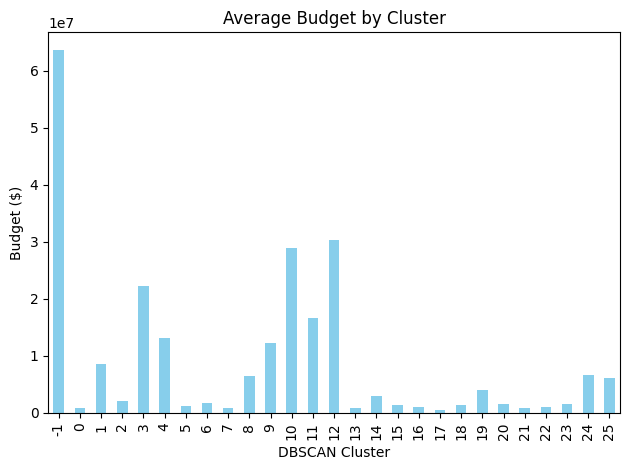

In [21]:
# Group by DBSCAN_Cluster and calculate summaries
cluster_summary = df_dummy.groupby('DBSCAN_Cluster').agg(
    Project_Count=('Latitude', 'count'),
    Avg_Budget=('Estimated Total Budget ($)', 'mean'),
    Median_Completion_Year=('Completion_Year', 'median')
).reset_index()

# Determine top category and status per cluster
def top_mode(series):
    return series.mode().iloc[0] if not series.mode().empty else None

top_status = df_dummy.groupby('DBSCAN_Cluster').apply(
    lambda x: 'Planning' if x['Status_Planning'].mode()[0] else 'Under construction'
).reset_index(name='Top_Status')

# Merge top status into summary
cluster_summary = cluster_summary.merge(top_status, on='DBSCAN_Cluster')

# Choose the most frequent category across all categories
def get_top_category(df):
    categories = ['Category_Recreation','Category_Communities', 'Category_Education', 'Category_Child care', 'Category_Roads and bridges', 'Category_Transit', 'Category_Health care']
    category_counts = df[categories].sum()
    return category_counts.idxmax().replace('Category_', '')

top_categories = df_dummy.groupby('DBSCAN_Cluster').apply(get_top_category).reset_index(name='Top_Category')

cluster_summary = cluster_summary.merge(top_categories, on='DBSCAN_Cluster')
print(cluster_summary)
cluster_summary.set_index('DBSCAN_Cluster')['Avg_Budget'].plot(
    kind='bar',
    title='Average Budget by Cluster',
    ylabel='Budget ($)',
    xlabel='DBSCAN Cluster',
    color='skyblue'
)
plt.tight_layout()
plt.show()


Explained variance ratio per PC: [0.77974118 0.09380888]
Total variance retained (2 PCs): 0.8735500580029272


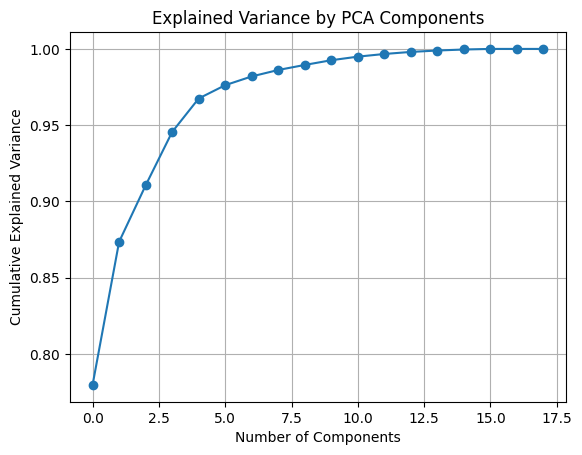

In [22]:
df_scaled.drop(['Latitude', 'Longitude'], axis=1)

# Set Pca
pca = PCA(n_components=2)
X_pca = pca.fit_transform(df_scaled)

# Explained variance
explained_variance = pca.explained_variance_ratio_
total_variance = explained_variance.sum()

print("Explained variance ratio per PC:", explained_variance)
print("Total variance retained (2 PCs):", total_variance)

pca_full = PCA().fit(df_scaled)
plt.plot(np.cumsum(pca_full.explained_variance_ratio_), marker='o')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Explained Variance by PCA Components')
plt.grid(True)
plt.show()



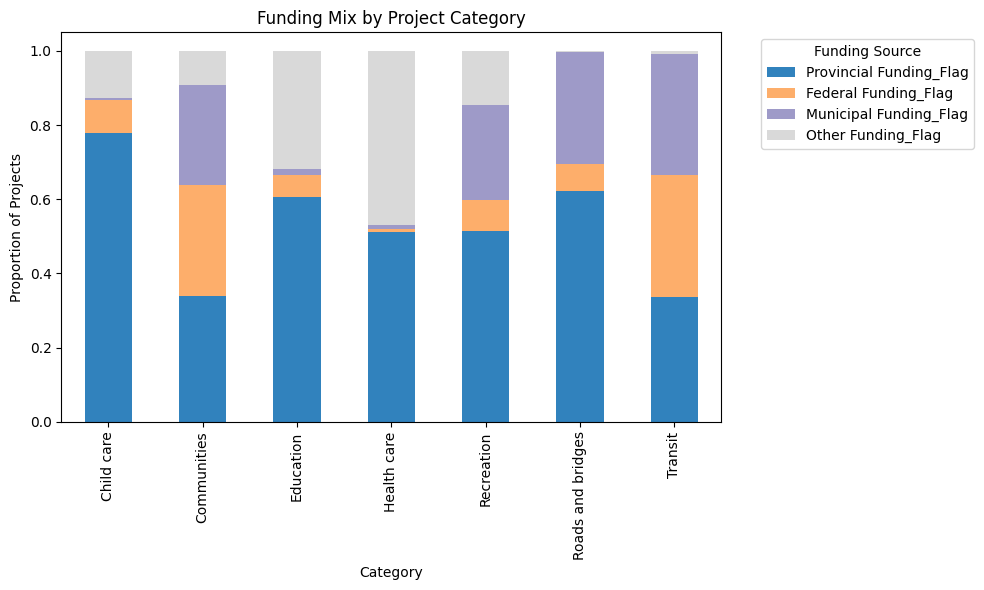

In [23]:
# Extract category columns
category_cols = [col for col in df_dummy.columns if col.startswith("Category_")]

# Convert to single category label
df_dummy['Category'] = df_dummy[category_cols].idxmax(axis=1).str.replace('Category_', '')

category_funding = df_dummy.groupby('Category').agg({
    'Provincial Funding_Flag': 'sum',
    'Federal Funding_Flag': 'sum',
    'Municipal Funding_Flag': 'sum',
    'Other Funding_Flag': 'sum'
})

# Normalize to percentage
category_funding_pct = category_funding.div(category_funding.sum(axis=1), axis=0)

category_funding_pct.plot(kind='bar', stacked=True, figsize=(10,6), colormap='tab20c')
plt.title('Funding Mix by Project Category')
plt.ylabel('Proportion of Projects')
plt.xlabel('Category')
plt.legend(title='Funding Source', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

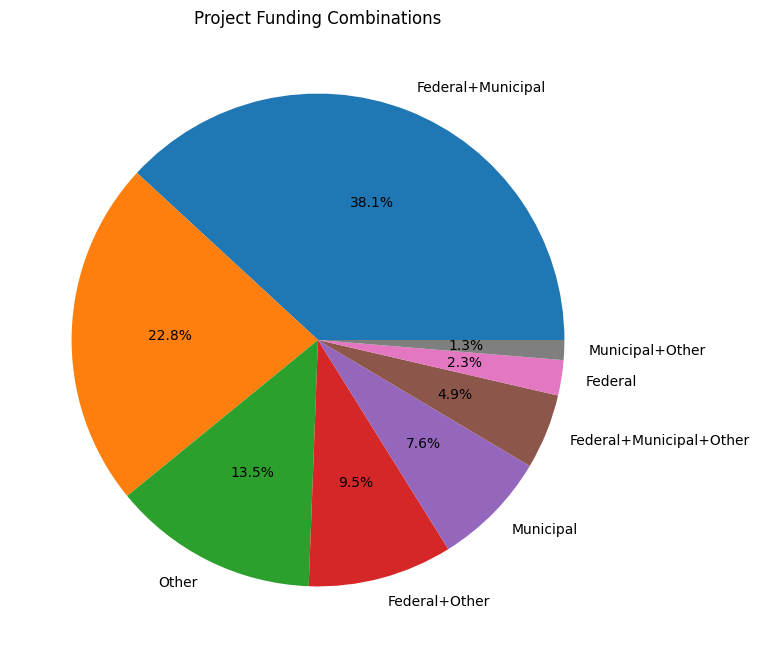

In [24]:
# Create a string to represent funding combo per row
df_dummy['Funding_Combo'] = df_dummy[['Federal Funding_Flag', 'Municipal Funding_Flag', 'Other Funding_Flag']].apply(
    lambda row: '+'.join([label for i, label in enumerate(['Federal', 'Municipal', 'Other']) if row[i] == 1]),
    axis=1
)

# Count combos
combo_counts = df_dummy['Funding_Combo'].value_counts()

combo_counts.plot(kind='pie', autopct='%1.1f%%', figsize=(8,8), ylabel='', title='Project Funding Combinations')
plt.show()


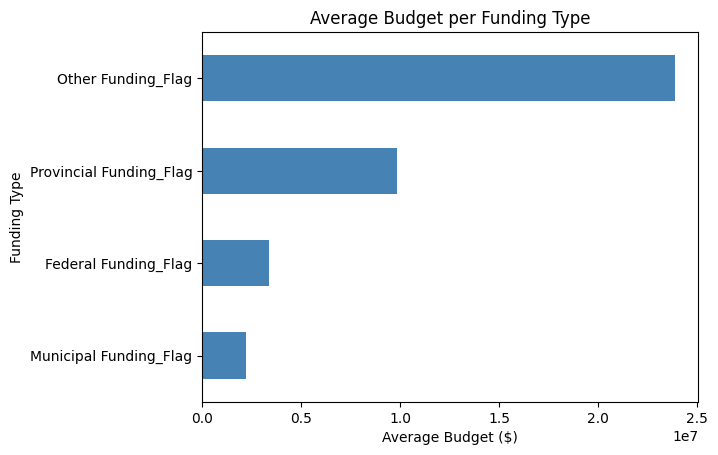

In [25]:
# Change funding flags into long format
funding_cols = ['Federal Funding_Flag', 'Provincial Funding_Flag', 'Municipal Funding_Flag', 'Other Funding_Flag']
df_melt = df_dummy.melt(id_vars=['Estimated Total Budget ($)'], value_vars=funding_cols,
                  var_name='Funding Type', value_name='Has Funding')

# Filter only rows with funding
df_melt = df_melt[df_melt['Has Funding'] == 1]
avg_budget = df_melt.groupby('Funding Type')['Estimated Total Budget ($)'].mean().sort_values()
avg_budget.plot(kind='barh', color='steelblue', title='Average Budget per Funding Type')
plt.xlabel('Average Budget ($)')
plt.show()


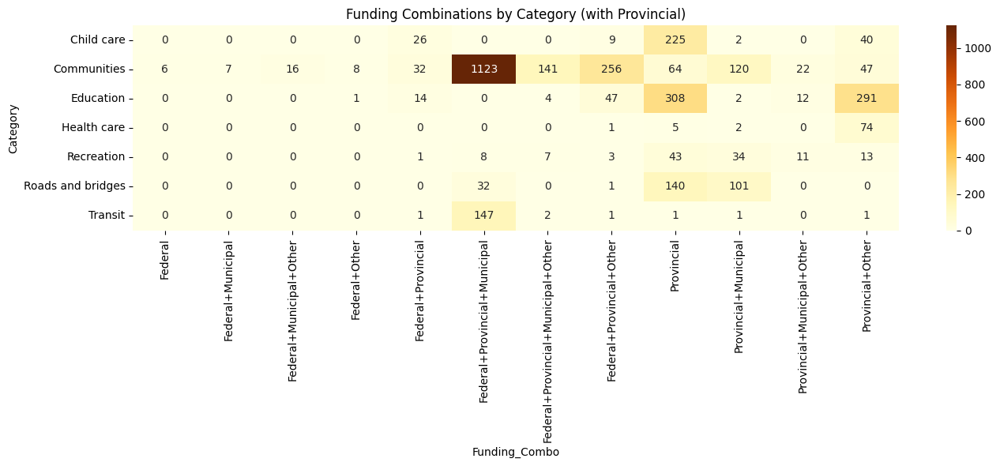

In [26]:
funding_cols = ['Federal Funding_Flag', 'Provincial Funding_Flag', 'Municipal Funding_Flag', 'Other Funding_Flag']
funding_labels = ['Federal', 'Provincial', 'Municipal', 'Other']

# Create combo label for funding
df_dummy['Funding_Combo'] = df_dummy[funding_cols].apply(
    lambda row: '+'.join([label for flag, label in zip(row, funding_labels) if flag == 1]) or 'None',
    axis=1
)

# Create pivot table: Category vs Funding Combo
combo_by_cat = df_dummy.pivot_table(index='Category', columns='Funding_Combo', aggfunc='size', fill_value=0)

plt.figure(figsize=(14,6))
sns.heatmap(combo_by_cat, annot=True, fmt='d', cmap='YlOrBr')
plt.title('Funding Combinations by Category (with Provincial)')
plt.tight_layout()
plt.show()



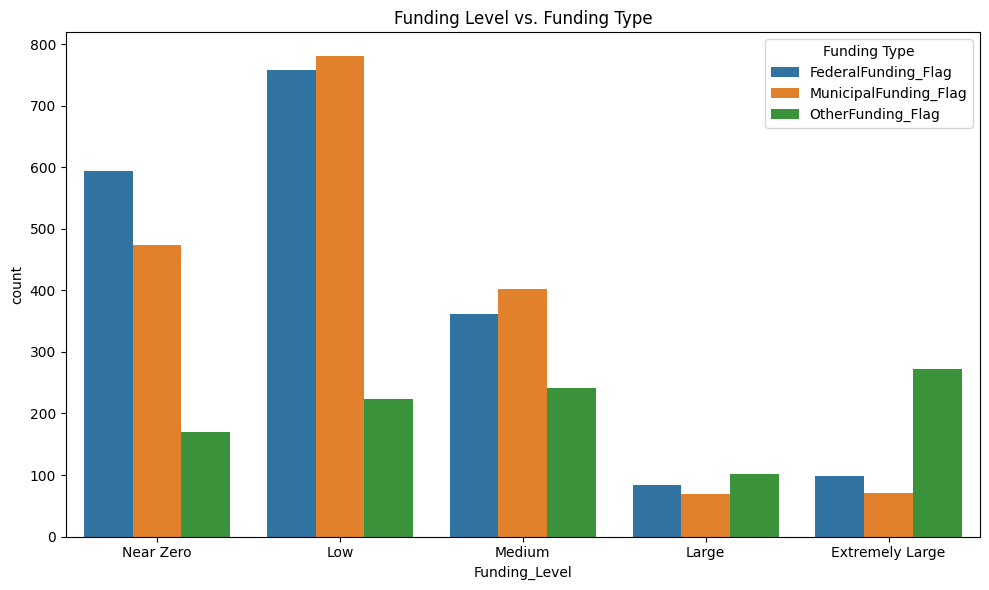

In [27]:
# Change to long format
df_melt_lvl = df_dummy.melt(id_vars=['Funding_Level'], 
                            value_vars=['Federal Funding_Flag', 'Municipal Funding_Flag', 'Other Funding_Flag'],
                            var_name='Funding Type', value_name='Has Funding')

df_melt_lvl = df_melt_lvl[df_melt_lvl['Has Funding'] == 1]

# Clean names
df_melt_lvl['Funding Type'] = df_melt_lvl['Funding Type'].str.replace('_Funding_Flag', '').str.replace(' ', '')

# Define ordered categories
funding_order = ['Near Zero','Low', 'Medium', 'Large', 'Extremely Large']
df_melt_lvl['Funding_Level'] = pd.Categorical(df_melt_lvl['Funding_Level'], categories=funding_order, ordered=True)

plt.figure(figsize=(10,6))
sns.countplot(data=df_melt_lvl, x='Funding_Level', hue='Funding Type')
plt.title('Funding Level vs. Funding Type')
plt.tight_layout()
plt.show()


In [28]:
Final_summary = df_dummy.groupby('DBSCAN_Cluster').agg({
    'Latitude': 'count',
    'Category': lambda x: x.value_counts().idxmax(),
    'Estimated Total Budget ($)': ['mean', 'median'],
    'Completion_Year': 'mean',
    'Provincial Funding_Flag': 'mean',
    'Federal Funding_Flag': 'mean',
    'Municipal Funding_Flag': 'mean',
    'Other Funding_Flag': 'mean'
})

Final_summary.columns = [
    'Project Count',
    'Most Common Category',
    'Average Budget ($)',
    'Median Budget ($)',
    'Average Completion Year',
    'Provincial Funding (%)',
    'Federal Funding (%)',
    'Municipal Funding (%)',
    'Other Funding (%)'

]

# Reset index to keep cluster label as a column
Final_summary.reset_index(inplace=True)
Final_summary.rename(columns={'DBSCAN_Cluster': 'Cluster'}, inplace=True)
# Create a mapping from cluster number to label
cluster_labels = df_noloc[['DBSCAN_Cluster', 'Cluster_Label']].drop_duplicates()
cluster_labels = cluster_labels.set_index('DBSCAN_Cluster')['Cluster_Label']

# Add Cluster_Label to Final_summary using map
Final_summary['Cluster Label'] = Final_summary['Cluster'].map(cluster_labels)

# Preview
print(Final_summary)



    Cluster  Project Count Most Common Category  Average Budget ($)   
0        -1            338          Communities        6.354468e+07  \
1         0            246          Communities        8.809752e+05   
2         1             55          Communities        8.669130e+06   
3         2             37          Communities        2.125278e+06   
4         3             43            Education        2.225418e+07   
5         4            258            Education        1.308952e+07   
6         5            218           Child care        1.138317e+06   
7         6             37           Child care        1.775032e+06   
8         7             23           Child care        8.735013e+05   
9         8            234            Education        6.544739e+06   
10        9             46            Education        1.222007e+07   
11       10             26            Education        2.886969e+07   
12       11             27            Education        1.666515e+07   
13    

In [29]:
Final_summary.to_csv("cluster_summary.csv", index=False)
print("Exported to cluster_summary.csv")

Exported to cluster_summary.csv
